# Packages

In [36]:
import math
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib import animation
from IPython.display import HTML
from mpl_toolkits.mplot3d import Axes3D

# Actual Dataset

In [37]:
file_path = 'Hanwella Area.xlsx'
data = pd.read_excel(file_path, sheet_name='Sheet1')

display(data)

,Precipitation,Glencourse Precipitation,Real Water Levels,Flood
0,0.01,0.01,1.65,0
1,0.79,0.79,1.57,0
2,1.52,1.52,1.53,0
3,0.88,0.88,1.65,0
4,0.23,0.23,1.64,0
...,...,...,...,...
8944,5.03,5.03,2.47,0
8945,2.56,2.56,2.41,0
8946,0.58,0.58,2.39,0
8947,2.86,2.86,2.10,0


## SCS CN Method

In [38]:
# Load the Excel file
file_path = 'Hanwella Area.xlsx'
data = pd.read_excel(file_path, sheet_name='Sheet1')

# Ensure column names are stripped of spaces (in case of hidden spaces)
data.columns = data.columns.str.strip()

# Define function to determine L0 based on water level
def determine_L0(rainfall):
    if 0 <= rainfall < 1:
        return 20
    elif 1 <= rainfall < 2:
        return 45
    elif 2 <= rainfall < 3:
        return 75
    elif 3 <= rainfall < 4:
        return 100
    elif 4 <= rainfall < 5:
        return 150
    else:
        return np.nan  # Handle unexpected values

# Apply the function to create a new L0 column
data['L0'] = data['Real Water Levels'].apply(determine_L0)

# Function to calculate effective precipitation (Pe)
def calculate_Pe(P, CN):
    S = 25400/CN - 254  # Retention coefficient
    S = np.maximum(0, S)  # Ensure S is non-negative
    Pe = ((P - 0.2 * S)**2) / (P + 0.8 * S)  # Avoid division by zero
    Pe = np.maximum(0, Pe)  # Ensure Pe is non-negative
    return Pe

# Function to calculate the new flow rate (Qnew)
def calculate_Qnew(Pe, L0, theta, nm, Slope, RH, As, W):
    q0 = Pe * L0 * np.cos(theta)  # Lateral flow contribution
    Q_channel = (1.49 / nm) * Slope**0.5 * RH**(2/3) * As  # Channel flow
    Qnew = Q_channel + q0 * W  # Combine lateral and channel flows
    return Qnew

# Input parameters
P = data["Precipitation"].to_numpy()  # Precipitation (mm)
CN = 80  # Curve number
theta = np.radians(4)  # Smaller angle for non-flood
nm = 0.03  # Manning's roughness
Slope = 0.003  # Reduced slope for non-flood conditions
RH = 2.5  # Smaller hydraulic radius
As = 180  # Reduced cross-sectional area (m²)
W = 20  # Narrower channel width (m)

# Calculate effective precipitation
Pe = calculate_Pe(P, CN)

# Calculate new flow rate dynamically using L0 from the dataset
Qnew = calculate_Qnew(Pe, data['L0'].to_numpy(), theta, nm, Slope, RH, As, W) / 1000  # Convert to m³/s

# Output Pe and Qnew as arrays
print("Effective Precipitation (Pe) Array:", Pe)
print("New Flow Rate (Qnew) Array:", Qnew)


Effective Precipitation (Pe) Array: [3.16937808 2.74952704 2.38899847 ... 2.85898015 1.80442788 1.5367844 ]
New Flow Rate (Qnew) Array: [3.7474606  3.37051514 3.04682983 ... 5.17999246 3.60201731 3.20153004]


# Contribution of Upstream Flow

In [39]:
# Runoff rate using the SCS Curve Number method
def calculate_runoff_rate(Pi, Ia, S):
    return np.where(Pi > Ia, ((Pi - Ia) ** 2) / (Pi - Ia + S), 0) / 1000  # Convert mm to meters

# Total inflow from subcatchments
def calculate_qinflow(areas, runoff_rates):
    return np.sum(np.array(areas)[:, None] * runoff_rates, axis=0)

# Momentum contribution from upstream inflow
def calculate_momentum_contribution(Qinflow, uin, vin):
    return Qinflow * uin, Qinflow * vin

# Example parameters
areas = [1000, 1500, 2000]
rainfall_depths = np.vstack([data["Glencourse Precipitation"]] * 3)  # Repeat for 3 subcatchments
runoff_rates = calculate_runoff_rate(rainfall_depths, 1, 5)

# Compute inflow & momentum
Qinflow = calculate_qinflow(areas, runoff_rates)
uin = 0.7
vin = 0.5
Qmomentum_x, Qmomentum_y = calculate_momentum_contribution(Qinflow, uin, vin)

print(f"Total Inflow (Qinflow): {Qinflow}")
print(f"Momentum Contribution x (Qmomentum_x): {Qmomentum_x}")
print(f"Momentum Contribution y (Qmomentum_y): {Qmomentum_y}")


Total Inflow (Qinflow): [0.         0.         0.22043478 ... 0.         2.26941691 3.90095238]
Momentum Contribution x (Qmomentum_x): [0.         0.         0.15430435 ... 0.         1.58859184 2.73066667]
Momentum Contribution y (Qmomentum_y): [0.         0.         0.11021739 ... 0.         1.13470845 1.95047619]


In [40]:
Qinflow = calculate_qinflow(areas, runoff_rates)
Qnew = calculate_Qnew(Pe, data['L0'].to_numpy(), theta, nm, Slope, RH, As, W) / 1000
P = data["Precipitation"].to_numpy()

# Configuaration

In [41]:
# Grid parameters
nx = 10 # Number of cells in x direction
ny = 10 # Number of cells in y direction
#nt = 100 # Number of time steps
nm = 0.035 # Manning's coefficient for friction
dx = 1.0 # cell size
dy = 1.0 # Cell size
dt = 0.01 # Time step
T = 4.0 # Total simulation time
g = 9.81 # Gravitational constant
epsilon = 1e-6  # Small epsilon to avoid division by zero

# Horton's infiltration model parameters
i0 = 30  # Initial infiltration rate (mm/min)
I = 2  # Final infiltration rate (mm/min)
r = 0.5  # Soil constant (min^-1)

# Initialize variables
h = np.ones((nx, ny))  # Water depth
u = np.zeros((nx, ny)) # Velocity in x-direction
v = np.zeros((nx, ny)) # Velocity in y-direction

# Topography (2D grid)
Z = np.zeros((nx + 4, ny + 4))  # Initialize flat topography
Z[int(nx/4):int(3*nx/4), int(ny/4):int(3*ny/4)] = 40  # Add a plateau
Z[int(nx/2), int(ny/2)] = 10  # Add a peak at the center for variation

## Conservative Variables U and Computaional Grid ( Cells and Ghost Cells )

In [42]:
# Initialize variables with ghost cells
U = np.zeros((nx + 4, ny + 4, 3))  # State variables with ghost cells

# Initialize U (initial conditions)
for i in range(1, nx + 1):
    for j in range(1, ny + 1):
        U[i, j, 0] = max(Z[i, j], 0)  # Initial water depth
        U[i, j, 1] = 0  # Initial momentum in x-direction
        U[i, j, 2] = 0  # Initial momentum in y-direction

# Initial water depth with a small bump in the center
U[2:nx+2, 2:ny+2, 0] = 0.8  # Initial water depth for interior cells
U[nx//2 + 2, ny//2 + 2, 0] = 5.5  # Center bump 

# Update ghost cells based on interior values
def apply_boundary_conditions(U):
    # Apply boundary conditions for ghost cells
    U[1, 2:ny+2, :] = U[2, 2:ny+2, :]  # Bottom boundary
    U[0, 2:ny+2, :] = U[3, 2:ny+2, :]  # Bottom ghost boundary
    
    U[nx+2, 2:ny+2, :] = U[nx+1, 2:ny+2, :]  # Top boundary
    U[nx+3, 2:ny+2, :] = U[nx, 2:ny+2, :]  # Top ghost boundary
    
    U[2:nx+2, 1, :] = U[2:nx+2, 2, :]  # Left boundary
    U[2:nx+2, 0, :] = U[2:nx+2, 3, :]  # Left ghost boundary
    
    U[2:nx+2, ny+2, :] = U[2:nx+2, ny+1, :]  # Right boundary
    U[2:nx+2, ny+3, :] = U[2:nx+2, ny, :]  # Right ghost boundary


## F Flux Calculation

In [43]:
# Function to calculate eigenvalues for F flux in x-direction
def compute_F_eigenvalues(u, h):
    beta_1 = u - np.sqrt(g * h)
    beta_2 = u
    beta_3 = u + np.sqrt(g * h)
    return beta_1, beta_2, beta_3

# Define the F flux function in the x-direction
def F_flux(U):
    h, hu, hv = U
    u = hu / h if h > 0 else 0
    return np.array([hu, hu * u + 0.5 * g * h ** 2, hu * (hv / h) if h > 0 else 0])

# Compute F flux using HLL scheme
def compute_F_HLL(UL, UR):
    hL, huL, hvL = UL
    hR, huR, hvR = UR
    uL = huL / hL if hL > 0 else 0
    uR = huR / hR if hR > 0 else 0
    beta_L = compute_F_eigenvalues(uL, hL)
    beta_R = compute_F_eigenvalues(uR, hR)
    Cx1 = min(min(beta_L), min(beta_R))
    Cx2 = max(max(beta_L), max(beta_R))
    FL = F_flux(UL)
    FR = F_flux(UR)
    if Cx1 >= 0:
        return FL
    elif Cx1 < 0 < Cx2:
        return (Cx2 * FL - Cx1 * FR + Cx1 * Cx2 * (UR - UL)) / (Cx2 - Cx1)
    else:
        return FR

# Time-stepping update in the x-direction
def update_U_x(U, nx, ny, dx, dt):
    U_new = U.copy()
    for i in range(1, nx + 1):
        for j in range(1, ny + 1):
            UL = U[i, j]
            UR = U[i + 1, j]
            UL_prev = U[i - 1, j]
            F_iphalf = compute_F_HLL(UL, UR)
            F_imhalf = compute_F_HLL(UL_prev, UL)
            U_new[i, j] = U[i, j] - (dt / dx) * (F_iphalf - F_imhalf)
    return U_new

## G Flux Calculation

In [44]:
# Function to calculate eigenvalues for G flux in y-direction
def compute_G_eigenvalues(v, h):
    beta_1 = v - np.sqrt(g * h)
    beta_2 = v
    beta_3 = v + np.sqrt(g * h)
    return beta_1, beta_2, beta_3

# Define the G flux function in the y-direction
def G_flux(U):
    h, hu, hv = U
    v = hv / h if h > 0 else 0
    return np.array([hv, hu * v, hv * v + 0.5 * g * h ** 2])

# Compute G flux using HLL scheme
def compute_G_HLL(UD, UU):
    hD, huD, hvD = UD
    hU, huU, hvU = UU
    vD = hvD / hD if hD > 0 else 0
    vU = hvU / hU if hU > 0 else 0
    beta_D = compute_G_eigenvalues(vD, hD)
    beta_U = compute_G_eigenvalues(vU, hU)
    Cy1 = min(min(beta_D), min(beta_U))
    Cy2 = max(max(beta_D), max(beta_U))
    GD = G_flux(UD)
    GU = G_flux(UU)
    if Cy1 >= 0:
        return GD
    elif Cy1 < 0 < Cy2:
        return (Cy2 * GD - Cy1 * GU + Cy1 * Cy2 * (UU - UD)) / (Cy2 - Cy1)
    else:
        return GU

# Time-stepping update in y-direction
def update_U_y(U, nx, ny, dy, dt):
    U_new = U.copy()
    for i in range(1, nx + 1):
        for j in range(1, ny + 1):
            UD = U[i, j]
            UU = U[i, j + 1]
            UD_prev = U[i, j - 1]
            G_jphalf = compute_G_HLL(UD, UU)
            G_jmhalf = compute_G_HLL(UD_prev, UD)
            U_new[i, j] = U[i, j] - (dt / dy) * (G_jphalf - G_jmhalf)
    return U_new

## Ss, Sf and Sp terms (Bottom slope, Friction and Source)

In [45]:
m = 0
P=P[m]
Qnew = Qnew[m]
Qinflow=Qinflow[m]

# Friction term (S_f) calculation
def friction_term(U, nx, ny, dx, dy):
    S_f = np.zeros_like(U)
    for i in range(1, nx + 1):
        for j in range(1, ny + 1):
            h = U[i, j, 0]
            hu = U[i, j, 1]
            hv = U[i, j, 2]
            # Calculate velocity components
            u = hu / h if h > 0 else 0
            v = hv / h if h > 0 else 0
            # Friction term (Manning's equation, assuming n_m = 0.03 for simplicity)
            n_m = 0.03
            S_f[i, j, 1] = -n_m**2 * np.sqrt(u**2 + v**2) * hu / (h + epsilon)**(4/3)
            S_f[i, j, 2] = -n_m**2 * np.sqrt(u**2 + v**2) * hv / (h + epsilon)**(4/3)
    return S_f


def precipitation_term(U, P, Qnew, Qinflow, nx, ny, dt, i0, I, r, uin, vin):
    S_p = np.zeros_like(U)

    for i in range(1, nx + 1):
        for j in range(1, ny + 1):
            h_n = U[i, j, 0]  # Water height at time t^n
            hu_n = U[i, j, 1]  # Momentum in x-direction at time t^n
            hv_n = U[i, j, 2]  # Momentum in y-direction at time t^n
            pn = P  # Total precipitation intensity

            # Calculate the available water in the cell (W)
            W = (2 / dt) * h_n + pn  # Available water for infiltration (Equation 21)

            # Intermediate infiltration (Horton model)
            infiltration_mid = I + (i0 - I) * (1 - np.exp(-r * dt / 2))  # Infiltration at midpoint
            infiltration_end = I + (i0 - I) * (1 - np.exp(-r * dt))  # Infiltration at full step

            if W <= I:  # If available water <= infiltration rate
                # Water height remains constant after infiltration
                h_n_half = h_n + (dt / 2) * pn  # No infiltration adjustment
                S_p[i, j, 0] = h_n_half
            else:  # When available water > infiltration capacity
                # Update water height using Equation 23
                h_n_half = h_n + (dt / 2) * pn - (infiltration_mid - I)
                h_n_plus1 = h_n + dt * pn - (infiltration_end - I)

                # Final water height adjustment
                S_p[i, j, 0] = h_n_half if dt / 2 else h_n_plus1

            # Add runoff contribution (scalar Qnew) to water height
            S_p[i, j, 0] += Qnew

            # Calculate momentum contributions from upstream inflow Qinflow
            Qmomentum_x = Qinflow * uin  # Momentum contribution in x-direction
            Qmomentum_y = Qinflow * vin  # Momentum contribution in y-direction

            # Update water height with mass contribution from Qinflow
            Qinflow_mass = Qinflow * dt
            S_p[i, j, 0] += Qinflow_mass  # Contribute inflow to water height

            # Update momentum in x and y directions
            S_p[i, j, 1] += Qmomentum_x  # Update momentum in x-direction (hu)
            S_p[i, j, 2] += Qmomentum_y  # Update momentum in y-direction (hv)

    return S_p


# Hydrostatic reconstruction for water height
def hydrostatic_reconstruction(h, Z, nx, ny):
    h_L = np.zeros((nx + 2, ny + 2))
    h_R = np.zeros((nx + 2, ny + 2))
    
    for i in range(1, nx + 1):
        for j in range(1, ny + 1):
            h_L[i, j] = max(h[i, j] + Z[i, j] - max(Z[i, j], Z[i + 1, j]), 0)
            h_R[i, j] = max(h[i + 1, j] + Z[i + 1, j] - max(Z[i, j], Z[i + 1, j]), 0)
    
    return h_L, h_R

# Bottom slope term (S_s) calculation considering hydrostatic reconstruction
def bottom_slope_term(U, Z, nx, ny, dx, dy):
    S_s = np.zeros_like(U)
    h = U[:, :, 0]  # Water depth
    h_L, h_R = hydrostatic_reconstruction(h, Z, nx, ny)
    
    for i in range(1, nx + 1):
        for j in range(1, ny + 1):
            P_L = 0.5 * g * h_L[i, j]**2
            P_R = 0.5 * g * h_R[i, j]**2
            
            # Update slope term for x and y directions
            S_s[i, j, 1] = -g * h[i, j] * (Z[i + 1, j] - Z[i - 1, j]) / dx
            S_s[i, j, 2] = -(P_R - P_L) / dy  # Includes topography effect in y-direction
            
    return S_s

# Main update function including source terms
def update_U_with_topography(U, Z, nx, ny, dx, dy, dt):
    S_s = bottom_slope_term(U, Z, nx, ny, dx, dy)
    
    # Update U considering the slope term
    U_new = U.copy()
    for i in range(1, nx + 1):
        for j in range(1, ny + 1):
            U_new[i, j, 1] += dt * S_s[i, j, 1]  # x-momentum update
            U_new[i, j, 2] += dt * S_s[i, j, 2]  # y-momentum update
    
    return U_new

## 2D Simulation

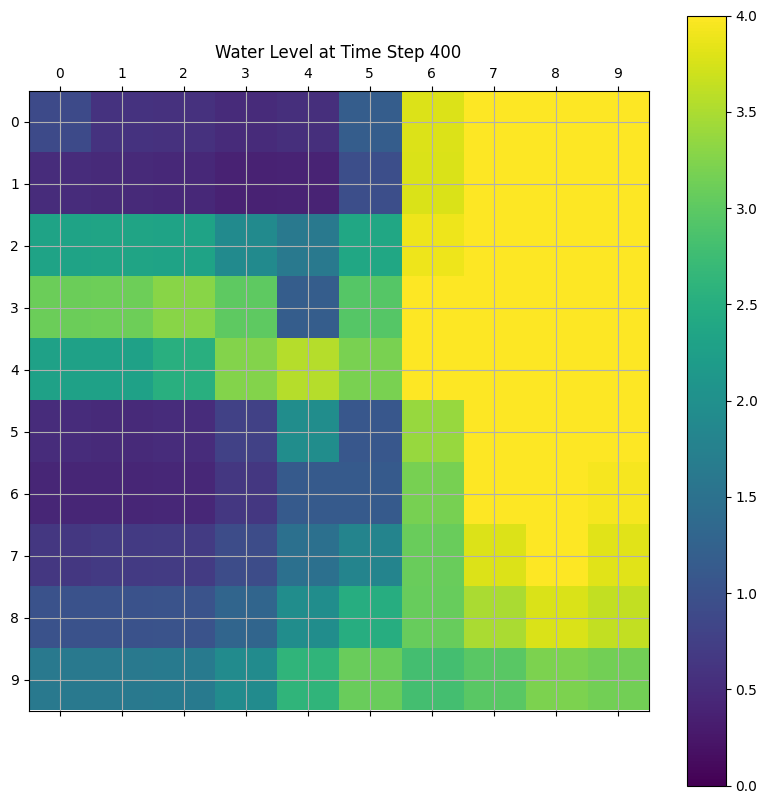

In [46]:
mpl.rcParams['animation.embed_limit'] = 280.0  # Set it to 280MB or any value that suits you

n_n = 400
# Animation setup
fig, ax = plt.subplots(figsize=(10, 10))
cax = ax.matshow(U[1:nx+1, 1:ny+1, 0], cmap='viridis', vmin=0, vmax=4)
fig.colorbar(cax, ax=ax)
ax.set_title('Water Level Over Time')

# Initialize arrays to store wave speeds over time
wave_speeds_x = np.zeros((n_n, nx, ny))  # Wave speeds in the x-direction
wave_speeds_y = np.zeros((n_n, nx, ny))  # Wave speeds in the y-direction

# Arrays to store F and G flux magnitudes
F_flux_magnitude = np.zeros((n_n, nx, ny))
G_flux_magnitude = np.zeros((n_n, nx, ny))

# Show grid lines
ax.grid(True)
water_depth_array = np.zeros((n_n, nx, ny))  # Array to store water depth at each time step
ax.set_xticks(np.arange(0, nx, 1))  # 1x1 spacing for x-axis
ax.set_yticks(np.arange(0, ny, 1))  # 1x1 spacing for y-axis

# Update function for animation
def animate(frame):
    global U
    apply_boundary_conditions(U)  # Apply boundary conditions

    # Calculate friction, precipitation, and bottom slope terms
    S_f = friction_term(U, nx, ny, dx, dy)
    S_p = precipitation_term(U, P, Qnew, Qinflow, nx, ny, dt, i0, I, r, uin, vin)
    S_s = bottom_slope_term(U, Z, nx, ny, dx, dy)

    # Step 1: Calculate U_n+1/4 (Intermediate step for friction and slope in x-direction)
    U_n_1_4 = np.copy(U)
    U_n_1_4[:, :, 1] += dt * (S_f[:, :, 1] + S_s[:, :, 1])
    U_n_1_4[:, :, 2] += dt * (S_f[:, :, 2] + S_s[:, :, 2])

    # Step 2: Update U_n+2/4 (Final update for friction and slope in x-direction)
    U_n_2_4 = np.copy(U_n_1_4)
    U_n_2_4[:, :, 1] += dt * (S_f[:, :, 1] + S_s[:, :, 1])
    U_n_2_4[:, :, 2] += dt * (S_f[:, :, 2] + S_s[:, :, 2])

    # Step 3: Calculate U_n+1 using precipitation in x-direction
    U[:, :, 0] += dt * S_p[:, :, 0]  # Update water depth with precipitation term
    U[:, :, 1] = U_n_2_4[:, :, 1]  # Update velocity components with intermediate values
    U[:, :, 2] = U_n_2_4[:, :, 2]
    
    # F flux and G flux
    U = update_U_x(U, nx, ny, dx, dt)
    U = update_U_y(U, nx, ny, dy, dt)
    
    # Compute flux vectors
    h = U[1:nx+1, 1:ny+1, 0]
    hu = U[1:nx+1, 1:ny+1, 1]
    hv = U[1:nx+1, 1:ny+1, 2]
    u = hu / np.maximum(h, 1e-6)
    v = hv / np.maximum(h, 1e-6)

    F_flux = np.stack([hu, hu * u + 0.5 * g * h**2, hu * v], axis=-1)
    G_flux = np.stack([hv, hu * v, hv * v + 0.5 * g * h**2], axis=-1)

    # Store magnitudes of fluxes
    F_flux_magnitude[frame] = np.sqrt(F_flux[..., 0]**2 + F_flux[..., 1]**2 + F_flux[..., 2]**2)
    G_flux_magnitude[frame] = np.sqrt(G_flux[..., 0]**2 + G_flux[..., 1]**2 + G_flux[..., 2]**2)
    
    # Store water depth for this time step
    water_depth_array[frame] = U[1:nx+1, 1:ny+1, 0]  # Store only interior grid (exclude ghost cells)
    wave_speeds_x[frame] = U[1:nx+1, 1:ny+1, 1] / np.maximum(U[1:nx+1, 1:ny+1, 0], 1e-6)  # u = momentum_x / depth
    wave_speeds_y[frame] = U[1:nx+1, 1:ny+1, 2] / np.maximum(U[1:nx+1, 1:ny+1, 0], 1e-6)  # v = momentum_y / depth
    
    # Update the visualization
    cax.set_array(U[1:nx+1, 1:ny+1, 0])  # Update water depth in the grid
    ax.set_title(f'Water Level at Time Step {frame + 1}')
    return [cax]

# Create animation
ani = animation.FuncAnimation(fig, animate, frames=n_n, blit= True, interval=n_n)

# Display inline in Jupyter Notebook
HTML(ani.to_jshtml())



# Water Height Array

In [47]:
# At the end of the simulation water_depth_array contains the water depth at each time step
print("Water depth array shape:", water_depth_array.shape)
print("Water depth array shape:\n", water_depth_array)

# Assuming "first entry" means the value at index [0, 0] of each 2D slice
first_entries_array = water_depth_array[:, 6, 6]
first_entries_array_01 = water_depth_array[:, 5, 5]
first_entries_array_02 = water_depth_array[:, 9, 9]
first_entries_array_03 = water_depth_array[:, 0, 0]

# Print the resulting array
print("First entries array over time:\n", first_entries_array)
print("First entries array over time:\n", first_entries_array_01)
print("First entries array over time:\n", first_entries_array_02)
print("First entries array over time:\n", first_entries_array_03)


Water depth array shape: (400, 10, 10)
Water depth array shape:
 [[[0.4440796  0.70734616 0.70809643 ... 0.98076825 0.98089626 0.97440201]
  [0.58770662 0.53851825 0.53354279 ... 0.9813754  0.9816111  0.97510379]
  [0.90738448 0.90643736 0.9059204  ... 0.98161464 0.981614   0.9751038 ]
  ...
  [1.44423065 1.51788759 1.52536294 ... 1.02873623 0.98418293 0.97515717]
  [1.05419474 1.05585274 1.05779997 ... 0.98419431 0.9815206  0.97494242]
  [0.97527358 0.97606568 0.97609087 ... 0.9751568  0.97493786 0.96904541]]

 [[0.56520563 0.60144184 0.59775095 ... 1.02686472 1.02725719 1.01750577]
  [0.47472604 0.43343065 0.42805341 ... 1.0274084  1.02799434 1.0182294 ]
  [0.92929186 0.92869714 0.92798363 ... 1.02795312 1.02800472 1.01822951]
  ...
  [1.68714305 1.75777562 1.76533818 ... 1.09864679 1.03333924 1.01840061]
  [1.21158719 1.2145217  1.21947261 ... 1.03331999 1.02789783 1.01791886]
  [1.02218143 1.02307509 1.02323876 ... 1.01839615 1.01791027 1.00929916]]

 [[0.64787994 0.49896553 0.4922

# Water Height and Average Water Height at the end of the simulation

In [48]:
# Function to get the water depth at the end of the simulation
def get_final_water_depth(U, nx, ny):
    water_depth = U[1:nx+1, 1:ny+1, 0]
    return water_depth

final_water_depth = get_final_water_depth(U, nx, ny)
print("Water Level at end of simulation :\n", final_water_depth)

average_water_depth = np.mean(final_water_depth)
print("Average Water Level :", average_water_depth)

Water Level at end of simulation :
 [[0.89887868 0.59191412 0.57735189 0.48808613 0.53502212 1.18749114
  3.78769821 4.54238986 4.64301358 4.02717317]
 [0.5049083  0.47472011 0.46226351 0.37973428 0.39805307 0.95680411
  3.76847058 4.53738563 4.64175033 4.02742789]
 [2.31889075 2.3284157  2.32065685 1.91015861 1.61801445 2.3791448
  3.89230969 4.54112607 4.62648368 4.01232572]
 [3.10649886 3.11421844 3.28765508 3.00657904 1.18430577 2.94961703
  4.0048202  4.56794647 4.63237492 4.01680593]
 [2.29206035 2.28510098 2.51928027 3.25674639 3.56243698 3.20060865
  4.10487801 4.6388475  4.68181199 4.07118167]
 [0.50403258 0.47173423 0.51128322 0.77039571 1.96623104 1.08875864
  3.37802327 4.30158651 4.52257436 4.02441197]
 [0.4235272  0.42535686 0.4495712  0.65233806 1.12909494 1.13015172
  3.17298176 4.04165061 4.33799288 3.94328364]
 [0.64520236 0.67590604 0.69819038 0.92762275 1.46949312 1.80858985
  3.09000762 3.7852428  4.104669   3.82510591]
 [1.00856083 1.00818545 1.03012933 1.30556226

# Water Elevation Contours at Specified Time Steps

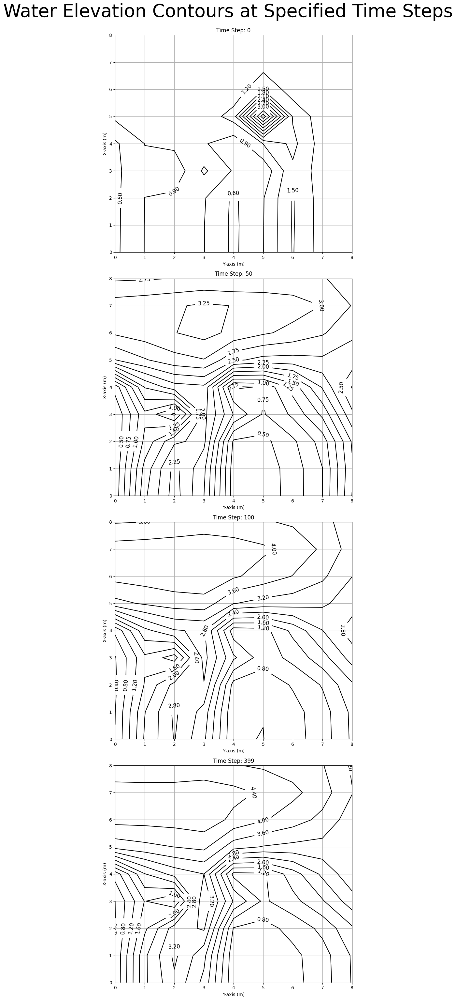

<Figure size 640x480 with 0 Axes>

In [49]:
# Time steps at which to plot the contours
time_steps_to_plot = [0, 50, 100, 399]

# Function to plot wave contours at specified time steps
def plot_wave_contours_at_specified_steps(water_depth_array, time_steps, nx, ny):
    plt.figure(figsize=(8, 30))  # Adjust the figure size (taller for a column)

    # Loop through each time step in the list
    for i, timestep in enumerate(time_steps):
        if timestep >= water_depth_array.shape[0]:  # Check if timestep exceeds available data
            print(f"Skipping timestep {timestep} (out of bounds)")
            continue

        # Extract the water depth at the current time step (excluding boundaries)
        water_depth = water_depth_array[timestep, 1:nx, 1:ny]  # Slice water depth without boundaries
        
        # Define your meshgrid for the 2D domain based on the shape of the water depth slice
        x = np.linspace(0, nx-2, nx-1)  # X-axis coordinates (nx-1 because of slicing)
        y = np.linspace(0, ny-2, ny-1)  # Y-axis coordinates (ny-1 because of slicing)
        X, Y = np.meshgrid(x, y)  # Create meshgrid based on the sliced shape

        # Create a subplot for each time step, arranged in a single column
        plt.subplot(len(time_steps), 1, i + 1)  # Each plot in one row of a single column
        contour = plt.contour(X, Y, water_depth.T, levels=12, colors='black', linewidths=1.5)
        plt.clabel(contour, inline=True, fontsize=12, fmt='%1.2f')  # Add labels to contours
        plt.title(f'Time Step: {timestep}')
        plt.xlabel('Y-axis (m)')
        plt.ylabel('X-axis (m)')
        plt.grid(True)

    plt.tight_layout()
    plt.suptitle('Water Elevation Contours at Specified Time Steps', fontsize=40, y=1.02)
    plt.show()

# Example usage with water_depth_array
total_timesteps = 1200  # Total simulation time steps
plot_wave_contours_at_specified_steps(water_depth_array, time_steps=time_steps_to_plot, nx=nx, ny=ny)
plt.savefig('combined_water_depth_plot.png', dpi=600, bbox_inches='tight')

In [50]:
# Function to save plots for each time step
def save_wave_contours_at_specified_steps(water_depth_array, time_steps, nx, ny):
    for timestep in time_steps:
        if timestep >= water_depth_array.shape[0]:
            print(f"Skipping timestep {timestep} (out of bounds)")
            continue
        
        water_depth = water_depth_array[timestep, 1:nx, 1:ny]
        x = np.linspace(0, nx-2, nx-1)
        y = np.linspace(0, ny-2, ny-1)
        X, Y = np.meshgrid(x, y)

        plt.figure(figsize=(8, 8))
        contour = plt.contour(X, Y, water_depth.T, levels=10, colors="black", linewidths=1.5)
        plt.clabel(contour, inline=True, fontsize=10, fmt='%1.2f')
        plt.title(f'Time Step: {timestep}')
        plt.xlabel('Y-axis (m)')
        plt.ylabel('X-axis (m)')
        plt.grid(True)
        plt.tight_layout()

        plt.savefig(f'time_step_{timestep}.png', dpi=600)
        plt.close()

# Call function to save plots
save_wave_contours_at_specified_steps(water_depth_array, time_steps_to_plot, nx=nx, ny=ny)


# Water height over time at all cells

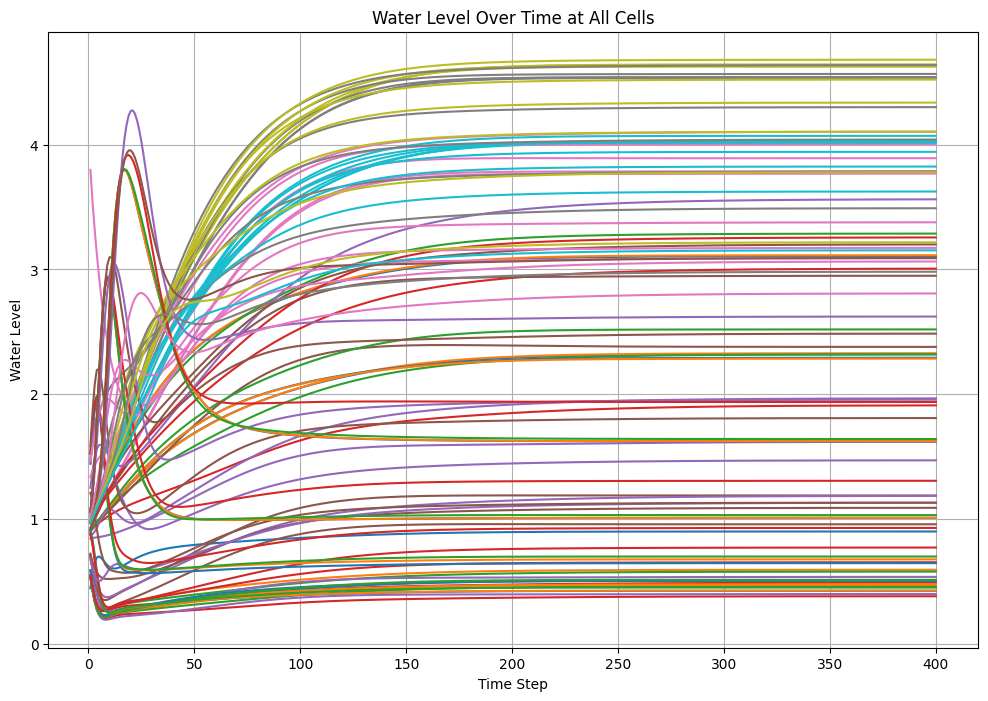

In [52]:
# Assume water_depth_array is a 3D array with dimensions (time_steps, grid_x, grid_y)
time_steps, grid_x, grid_y = water_depth_array.shape

# Plot all cells in a single graph
plt.figure(figsize=(12, 8))

# Loop through all grid cells (assuming a 10x10 grid)
for i in range(grid_x):
    for j in range(grid_y):
        cell_depths = water_depth_array[:, i, j]  # Extract water depths for cell (i, j) over time
        plt.plot(range(1, len(cell_depths) + 1), cell_depths, linestyle='-')

# Add labels, title, and grid
plt.xlabel('Time Step')
plt.ylabel('Water Level')
plt.title('Water Level Over Time at All Cells')
plt.grid(True)

# Save the plot to a file
plt.savefig('all_cells_water_level_plot.png', dpi=300, bbox_inches='tight')

# Display the plot
plt.show()


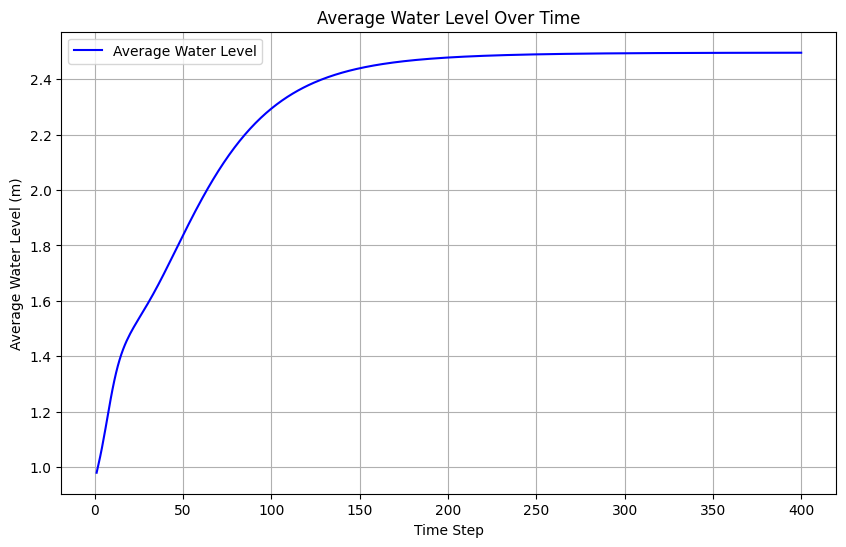

In [53]:
import matplotlib.pyplot as plt

# Calculate the average water depth for each time step
average_water_depth = np.mean(water_depth_array, axis=(1, 2))  # Mean across spatial dimensions

# Plot the average water depth over time
plt.figure(figsize=(10, 6))
plt.plot(range(1, n_n + 1), average_water_depth, label='Average Water Level', color='blue')
plt.xlabel('Time Step')
plt.ylabel('Average Water Level (m)')
plt.title('Average Water Level Over Time')
plt.grid(True)
plt.legend()
plt.show()


# Wave Speeds in X and Y directions

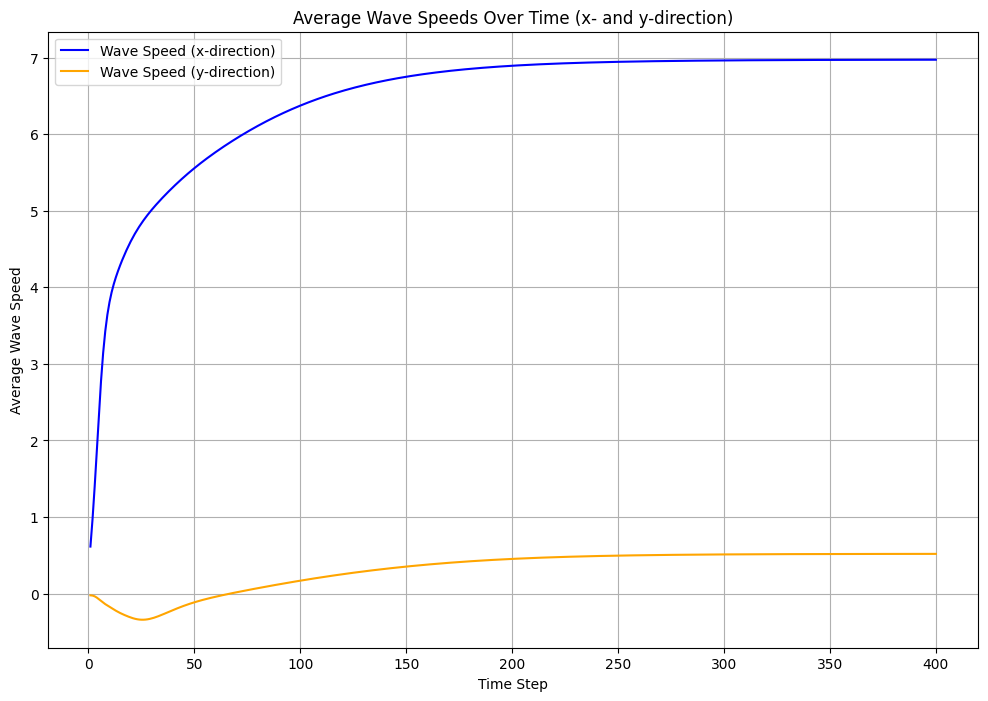

In [54]:
# Compute average wave speeds
avg_wave_speed_x = np.mean(wave_speeds_x, axis=(1, 2))  # Average over all grid points in x-direction
avg_wave_speed_y = np.mean(wave_speeds_y, axis=(1, 2))  # Average over all grid points in y-direction

# Create a single plot
plt.figure(figsize=(12, 8))
plt.plot(range(1, n_n +1), avg_wave_speed_x, label='Wave Speed (x-direction)', color='blue')
plt.plot(range(1, n_n +1), avg_wave_speed_y, label='Wave Speed (y-direction)', color='orange')
plt.xlabel('Time Step')
plt.ylabel('Average Wave Speed')
plt.title('Average Wave Speeds Over Time (x- and y-direction)')
plt.legend()
plt.grid(True)

# Save the combined plot
plt.savefig('wave_speeds_combined_plot.png', dpi=300, bbox_inches='tight')
plt.show()


# Average F flux and G flux

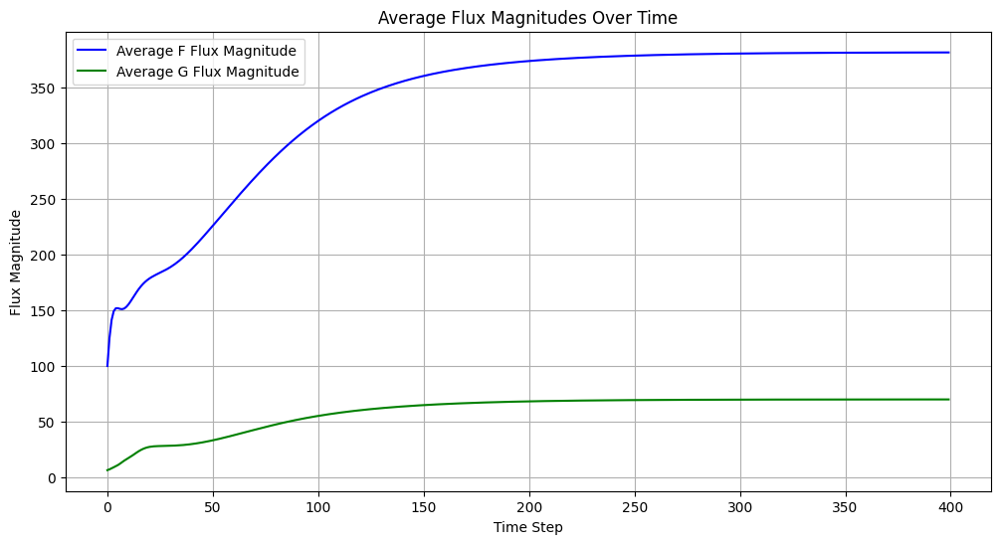

In [55]:
# Plot F and G flux magnitudes for a single cell or average
time_steps = np.arange(n_n)

# Average magnitudes over the domain
F_flux_avg = np.mean(F_flux_magnitude, axis=(1, 2))
G_flux_avg = np.mean(G_flux_magnitude, axis=(1, 2))

plt.figure(figsize=(12, 6))
plt.plot(time_steps, F_flux_avg, label='Average F Flux Magnitude', color='blue')
plt.plot(time_steps, G_flux_avg, label='Average G Flux Magnitude', color='green')
plt.xlabel('Time Step')
plt.ylabel('Flux Magnitude')
plt.title('Average Flux Magnitudes Over Time')
plt.legend()
plt.grid(True)
plt.show()
